In [1]:
import os
# Seleccio GPUs visibles
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID" 
os.environ["CUDA_VISIBLE_DEVICES"]="3,4"

In [2]:
import torch
import torch.optim as optim
import torchvision
from torchvision import transforms
from torchvision.transforms.functional import to_tensor
from torchvision.transforms import Resize
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torchvision.transforms.functional as TF
import torch.nn as nn
%cd /tf/detectron2
import detectron2
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog
from detectron2.data import DatasetCatalog
from detectron2.data import transforms as T
from detectron2.utils.logger import setup_logger
setup_logger()
from PIL import Image, ImageDraw
from scipy.optimize import linear_sum_assignment
import torch.nn.functional as F
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import json
from torchviz import make_dot
import copy
from sklearn.metrics import precision_recall_fscore_support
import random
import albumentations as A

/tf/detectron2


In [3]:
# xmin, ymin, xmax, ymax to xmin, ymin, w, h
def xyxy_to_xywh(coordenadas, clamp=False):
    if type(coordenadas) != type(torch.tensor(0)):
        coordenadas = torch.tensor(coordenadas)
    coordenadas = torch.stack((coordenadas[:, 0],
                               coordenadas[:, 1],
                               coordenadas[:, 2] - coordenadas[:, 0],
                               coordenadas[:, 3] - coordenadas[:, 1]
                               ), dim=1)
    if clamp:
        coordenadas = torch.clamp(coordenadas, min=0, max=1)
    return coordenadas

# xmin, ymin, w, h to xmin, ymin, xmax, ymax
def xywh_to_xyxy(coordenadas, clamp=False):
    if type(coordenadas) != type(torch.tensor(0)):
        coordenadas = torch.tensor(coordenadas)
    coordenadas = torch.stack((coordenadas[:, 0], 
                               coordenadas[:, 1], 
                               coordenadas[:, 0] + coordenadas[:, 2],
                               coordenadas[:, 1] + coordenadas[:, 3]
                               ), dim=1)
    if clamp:
        coordenadas = torch.clamp(coordenadas, min=0, max=1)    
    return coordenadas

# cx, cy, w, h to xmin, ymin, xmax, ymax
def cxcywh_to_xyxy(coordenadas, clamp=False):
    if type(coordenadas) != type(torch.tensor(0)):
        coordenadas = torch.tensor(coordenadas)
    coordenadas = torch.stack((coordenadas[:, 0] - coordenadas[:, 2] / 2,
                               coordenadas[:, 1] - coordenadas[:, 3] / 2,
                               coordenadas[:, 0] + coordenadas[:, 2] / 2,
                               coordenadas[:, 1] + coordenadas[:, 3] / 2
                               ), dim=1)
    if clamp:
        coordenadas = torch.clamp(coordenadas, min=0, max=1)    
    return coordenadas

# xmin, ymin, xmax, ymax to cx, cy, w, h
def xyxy_to_cxcywh(coordenadas, clamp=False):
    if type(coordenadas) != type(torch.tensor(0)):
        coordenadas = torch.tensor(coordenadas)
    coordenadas = torch.stack(((coordenadas[:, 0] + coordenadas[:, 2]) / 2,
                               (coordenadas[:, 1] + coordenadas[:, 3]) / 2,
                               coordenadas[:, 2] - coordenadas[:, 0],
                               coordenadas[:, 3] - coordenadas[:, 1]
                               ), dim=1)
    if clamp:
        coordenadas = torch.clamp(coordenadas, min=0, max=1)    
    return coordenadas

# cx, cy, w, h to xmin, ymin, w, h
def cxcywh_to_xywh(coordenadas, clamp=False):
    if type(coordenadas) != type(torch.tensor(0)):
        coordenadas = torch.tensor(coordenadas)
    coordenadas = torch.stack((coordenadas[:, 0] - coordenadas[:, 2] / 2,
                               coordenadas[:, 1] - coordenadas[:, 3] / 2,
                               coordenadas[:, 2],
                               coordenadas[:, 3]
                               ), dim=1)
    if clamp:
        coordenadas = torch.clamp(coordenadas, min=0, max=1)    
    return coordenadas

In [4]:
class PoolDetectionModel(nn.Module):
    def __init__(self, num_classes, num_predictions = 100):
        super(PoolDetectionModel, self).__init__()
        
        # Cargamos el modelo pre-entrenado
        self.model = torch.hub.load('facebookresearch/detr:main', 'detr_resnet50', pretrained=True)

        # Cambiamos el número de clases de salida
        hidden_dim = self.model.transformer.d_model
        self.model.num_classes = num_classes
        self.model.class_embed = nn.Linear(hidden_dim, num_classes)
        
        # Cambiamos el número predicciones
        if num_predictions != 100:
            num_query = self.model.transformer.d_model
            self.model.query_embed = nn.Embedding(num_predictions, num_query)
                
    def forward(self, x):
        # Pasamos las imágenes por el modelo pre-entrenado
        outputs = self.model(x)
        
        # Obtenemos las cajas y las etiquetas de las predicciones
        outputs['pred_logits'] = torch.sigmoid(outputs['pred_logits'])
        
        # Devolvemos las cajas y las etiquetas
        return outputs

In [5]:
PoolDetectionModel(1)

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


PoolDetectionModel(
  (model): DETR(
    (transformer): Transformer(
      (encoder): TransformerEncoder(
        (layers): ModuleList(
          (0-5): 6 x TransformerEncoderLayer(
            (self_attn): MultiheadAttention(
              (out_proj): NonDynamicallyQuantizableLinear(in_features=256, out_features=256, bias=True)
            )
            (linear1): Linear(in_features=256, out_features=2048, bias=True)
            (dropout): Dropout(p=0.1, inplace=False)
            (linear2): Linear(in_features=2048, out_features=256, bias=True)
            (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
            (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
            (dropout1): Dropout(p=0.1, inplace=False)
            (dropout2): Dropout(p=0.1, inplace=False)
          )
        )
      )
      (decoder): TransformerDecoder(
        (layers): ModuleList(
          (0-5): 6 x TransformerDecoderLayer(
            (self_attn): MultiheadAttention(
  

In [6]:
def declarar_modelo(paths, paramaters, Load_model = False, current_test = False, current_epoch = False):
    # Calculate current number of test
    if not current_test or not Load_model:
        current_test = get_current_test(paths["tests"])
    if Load_model:
        # Load model
        model = PoolDetectionModel(num_classes=paramaters["num_classes"], num_predictions = paramaters["num_predictions"])
        # Path to current test
        path_current_test = f'{paths["tests"]}test {current_test}/'
        paths["test"] = path_current_test
        # Calculate current epoch in test
        if not current_epoch:
            current_epoch = get_current_epoch(path_current_test)
        # Load model parameters
        model = torch.load(f'{path_current_test}model_{current_epoch}.pt')
        # Get previus losses
        with open(f"{path_current_test}model_loss_{current_epoch}.json", 'r') as f:
            train_loss = json.load(f)
        with open(f"{path_current_test}parameters.json", 'r') as f:
            paramaters = json.load(f)
        paramaters["current_epoch"] = current_epoch+1
        print(f"Load model {path_current_test}model_{current_epoch}.pt")
        print(f"Load parameters {paramaters}")
    else:
        # Create list of losses
        train_loss = [[], []]
        # Load model
        model = PoolDetectionModel(num_classes=paramaters["num_classes"])#, num_predictions = paramaters["num_predictions"])
        # Path to new test
        path_current_test = f'{paths["tests"]}test {current_test+1}/'
        # Create directori of the new test
        os.makedirs(path_current_test)
        # Save parameters
        with open(f"{path_current_test}parameters.json", 'w') as f:
            json.dump(paramaters, f)
        paths["test"] = path_current_test
        paramaters["current_epoch"] = 1
        print("New Model")
        print(path_current_test)
        print(f"Parameters {paramaters}")
    return model, paramaters, train_loss

def get_current_epoch(path):
    list_names = os.listdir(path)
    list_names = [int(namefile[6:-3]) for namefile in list_names if namefile.endswith(".pt")]
    return max(list_names)

def get_current_test(path):
    list_tests = sorted(os.listdir(path))
    list_tests.pop(0)
    list_tests = [int(namefile[5:]) for namefile in list_tests]
    return max(list_tests)

In [7]:
def collate_fn(batch):
    images = []
    targets = []
    # Define the normalization transform
    resize = transforms.Resize(new_size, antialias=None)
    normalize = transforms.Normalize(mean=[0.53016539, 0.48067732, 0.410102], std=[0.25151319, 0.2374013, 0.23417556])
    transform = transforms.Compose([transforms.ToTensor(), resize, normalize])
    for sample in batch:
        image = Image.open(sample['file_name']).convert('RGB')
        width, height = image.size
        # Transformar la imagen
        image = transform(image)
        # Adaptar las anotaciones
        annotations = copy.deepcopy(sample['annotations'])
        for ann in annotations:
            bbox = ann['bbox']
            x_original, y_original, w_original, h_original = bbox
            x_new = x_original / width #* new_size[1]
            y_new = y_original / height #* new_size[0]
            w_new = w_original / width #* new_size[1]
            h_new = h_original / height #* new_size[0]
            ann['bbox'] = [x_new, y_new, w_new, h_new]        
        # Añadir la imagen y las anotaciones a la lista
        if len(annotations) != 0:
            images.append(torch.tensor(image))
            targets.append({'boxes': torch.tensor([ann['bbox'] for ann in annotations]), 'labels': [1 for ann in annotations]})
    return images, targets

In [8]:
def train(model, optimizer, data_loader, device, losses, epochs, current_epoch):
    model.train()

    for name, param in model.named_parameters():
        if False:
#         if "embed" not in name and "decoder" not in name:
            param.requires_grad = False
        else:
            param.requires_grad = True
            print("No congelando:", name)
    for epoch in range(current_epoch, epochs):
        print("\nEpoch:", epoch, "\n")
        loss_epoch = []
        for images, targets in tqdm(data_loader):
#             images = copy.deepcopy(images_)
#             targets = copy.deepcopy(targets_)
            images = [image.to(device) for image in images]
#             targets = [{k: v for k, v in t.items()} for t in targets]
#             print(targets)
            optimizer.zero_grad()
            output = model(images)
            loss = hungarian_loss_2(output, targets)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm = 0.1, norm_type = 2)
#             make_dot(loss, params=dict(model.named_parameters()), show_attrs=True, show_saved=True).render('graph', format='pdf', directory='/tf')
#             return
            optimizer.step()
            scheduler.step()
            loss = loss.item()/len(images)
            loss_epoch.append(loss)
        loss_train = sum(loss_epoch)/len(loss_epoch)
        loss_validation = validation(model)
        losses[0].append(loss_train)
        losses[1].append(loss_validation)
        model.train()
        torch.save(model, f"{paths['test']}model_{epoch}.pt")
        with open(f"{paths['test']}model_loss_{epoch}.json", 'w') as f:
            json.dump(losses, f)
        paramaters["current_epoch"] = epoch+1
        print(" Model saved")
        print("loss train:", loss_train)
        print("loss validation:", loss_validation)
        print(cxcywh_to_xyxy(output["pred_boxes"][0])[0])

    return


In [9]:
def validation(model):
    model.eval()
    losses_val = []
    for images, targets in tqdm(data_loader_validation):
        images = [image.to(device) for image in images]
#         targets = [{k: v for k, v in t.items()} for t in targets]
        output = model(images)
        loss = hungarian_loss_2(output, targets)
        loss = loss.item()/len(images)
        losses_val.append(loss)
    return sum(losses_val)/len(losses_val)

In [10]:
def hungarian_loss_2(outputs, targets):
    # reorder outputs and targets based in the hungarian algorithm without breaking the computation graph
    # outputs are the predicted bounding boxes and labels in the format ([batch_size, num_queries, 4], [batch_size, num_queries, num_classes])
    # targets are the ground truth bounding boxes and labels in the format [{'boxes': [x1, y1, x2, y2], 'labels': [0, 1, 2, 3]}, {'boxes': [x1, y1, x2, y2], 'labels': [0, 1, 2, 3]}]
    # the loss is calculated as the sum of the l1 loss, the iou loss and the classification loss    
    # convert the targets to the same format as the outputs
    true_boxes = [target['boxes'].to(device=device, dtype=torch.float32) for target in targets]
    true_labels = [torch.tensor(target['labels'], dtype=torch.float32).to(device) for target in targets]
    
    l1 = 0
    iou = 0
    classification = 0
    
    for n in range(len(true_boxes)):
        row_ind, col_ind = hungarian((xywh_to_xyxy(true_boxes[n]), true_labels[n]), (cxcywh_to_xyxy(outputs["pred_boxes"][n]), outputs['pred_logits'][n]))
        # Calculate the losses
        p_boxes = cxcywh_to_xyxy(outputs["pred_boxes"][n][row_ind])
        t_boxes = xywh_to_xyxy(true_boxes[n][col_ind])
        mask_row = torch.ones(outputs['pred_logits'][n].shape, dtype=torch.bool)
        mask_row[row_ind] = False
        p_label = torch.cat((outputs['pred_logits'][n][row_ind], outputs['pred_logits'][n][mask_row].unsqueeze(1)), 0)
        t_label = torch.cat((true_labels[n][col_ind].unsqueeze(1), torch.zeros(p_label.shape[0]-len(col_ind)).to(device).unsqueeze(1)))
        l1 = l1 + torch.nn.functional.l1_loss(p_boxes, t_boxes)
        # iou = torchvision.ops.complete_box_iou_loss(pred_boxes, true_boxes, reduction = "mean")
#         print(cxcywh_to_xyxy(outputs["pred_boxes"][n][row_ind])[0], xywh_to_xyxy(true_boxes[n][col_ind])[0])
        iou = iou + torchvision.ops.generalized_box_iou_loss(p_boxes, t_boxes, reduction = "mean")
        classification = classification + torch.nn.functional.binary_cross_entropy(p_label, t_label)

    # Combinamos las losses
    l1_weight, iou_weight, classification_weight = 5, 2, 2
    loss = l1_weight * l1 + iou_weight * iou + classification_weight * classification    
    return loss

def hungarian(true, pred):
    true_boxes, true_labels = true
    boxes, labels = pred
    
    true_labels = true_labels.unsqueeze(1)
    
    # Calculamos el costo de emparejamiento entre las cajas predichas y verdaderas
    cost_boxes = torch.cdist(boxes, true_boxes, p=1)
    
    # Calculamos el costo de emparejamiento entre las etiquetas predichas y verdaderas
    cost_labels = torch.cdist(labels, true_labels, p=1)
    
    # Combinamos los costos
    cost = cost_boxes + cost_labels
    
    # Resolvemos el problema de asignación lineal
    row_ind, col_ind = linear_sum_assignment(cost.cpu().detach().numpy())
    
    return row_ind, col_ind

In [11]:
def collate_fn_memoria(batch):
    images = []
    targets = []
    for sample in batch:
        if sample["image_id"] < len(list_images):
            images.append(list_images[sample["image_id"]-1])
            target = list_targets[sample["image_id"]-1]
            target["labels"] = [1]*len(target["boxes"])
            targets.append(list_targets[sample["image_id"]-1])
    return images, targets

In [12]:
def Cargar_dataset_memoria(dataset, batch_size):
    images = []
    targets = []
    resize = transforms.Resize(new_size, antialias=None)
    normalize = transforms.Normalize(mean=[0.53016539, 0.48067732, 0.410102], std=[0.25151319, 0.2374013, 0.23417556])
    transform = transforms.Compose([transforms.ToTensor(), resize, normalize])
    for sample in tqdm(dataset):
        # Define the normalization transform
        image = Image.open(sample['file_name']).convert('RGB')
        width, height = image.size
        # Transformar la imagen
        image = transform(image)
        # Adaptar las anotaciones
        annotations = sample['annotations']
        for ann in annotations:
            bbox = ann['bbox']
            x_original, y_original, w_original, h_original = bbox
            x_new = x_original / width #* new_size[1]
            y_new = y_original / height #* new_size[0]
            w_new = w_original / width #* new_size[1]
            h_new = h_original / height #* new_size[0]
            ann['bbox'] = [x_new, y_new, w_new, h_new]
        # Añadir la imagen y las anotaciones a la lista
        if len(annotations) != 0:
            images.append(image)
            targets.append({'boxes': [ann['bbox'] for ann in annotations], 'labels': [1 for ann in annotations]})
    return images, targets

In [13]:
def collate_fn_memoria_aumentation(batch):
    transform = A.Compose( [A.HorizontalFlip(p=0.5), A.VerticalFlip(p=0.5), A.RandomRotate90(0.5)], 
                            #A.RandomBrightnessContrast(p=0.5), A.PixelDropout(p=0.5)], 
                          bbox_params=A.BboxParams(format='albumentations', label_fields=["class_labels"]))
#     A.GaussNoise(), A.RandomScale()
    images = []
    targets = []
    for sample in batch:
        if sample["image_id"] < len(list_images):
            target = copy.deepcopy(list_targets[sample["image_id"]-1])
            image = copy.deepcopy(list_images[sample["image_id"]-1])
            image = np.moveaxis(np.array(image), 0, -1)
            
            target["boxes"] = xywh_to_xyxy(target["boxes"], clamp = True)
            transformed = transform(image=image, bboxes=target["boxes"], class_labels=target["labels"])
            
            image = np.moveaxis(transformed["image"], 2, 0)            
            
            images.append(torch.tensor(image))
            targets.append({"boxes": xyxy_to_xywh(transformed["bboxes"]), "labels": transformed["class_labels"]})

    return images, targets

In [21]:
# path_dataset = "/tf/data/tmp/PoolsDS/"
# paths = {"dataset": f"{path_dataset}",
#          "tests": f"{path_dataset}tests/",
#          "annotations_train": f"{path_dataset}annotations_4_recounted_train.json",
#          "annotations_test": f"{path_dataset}annotations_4_recounted_test.json",
#          "images": f"{path_dataset}images"
#          }
path_dataset = "/tf/data/tmp/PoolsDS/Dataset improved 3/"
paths = {"dataset": f"{path_dataset}",
         "tests": f"{path_dataset}tests/",
         "annotations_train": f"{path_dataset}train/_annotations.coco.json",
         "annotations_test": f"{path_dataset}test/_annotations.coco.json",
         "annotations_validation": f"{path_dataset}valid/_annotations.coco.json",
         "images_train": f"{path_dataset}train/",
         "images_test": f"{path_dataset}test/",
         "images_validation": f"{path_dataset}valid/"
         }

paramaters = {"learning_rate": 10**(-4),
              "max_lr": 10**(-4),
              "momentum": 0.9,
              "batch_size": 8,
              "epochs": 100, 
              "num_classes": 1,
              "num_predictions": 300,
              "weight_decay": 10**(-4),
              "notes": ""
              }


Load_model = True
new_size = (700, 700)

# Declarar el modelo 
model, paramaters, train_loss = declarar_modelo(paths, paramaters, Load_model = Load_model, current_test = 58)

# Declarar el optimizador
# optimizer = optim.SGD(model.parameters(), lr=paramaters["learning_rate"], momentum=paramaters["momentum"])
optimizer = optim.AdamW(model.parameters(), lr=paramaters["learning_rate"], weight_decay=paramaters["weight_decay"])

# Declarar el scheduler
scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, base_lr=paramaters["learning_rate"], max_lr=paramaters["max_lr"], cycle_momentum=False)
# scheduler = None
print("Comprobando device")
# Declarar el dispositivo
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("Utilizando :", device)

# Mover el modelo y el DataLoader al dispositivo
model.to(device);

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


Load model /tf/data/tmp/PoolsDS/Dataset improved 3/tests/test 58/model_271.pt
Load parameters {'learning_rate': 0.0001, 'max_lr': 0.0001, 'momentum': 0.9, 'batch_size': 8, 'epochs': 500, 'num_classes': 1, 'num_predictions': 300, 'weight_decay': 0.0001, 'notes': '', 'current_epoch': 272}
Comprobando device
Utilizando : cuda


In [15]:
DatasetCatalog.clear()
MetadataCatalog.clear()

print("Load data")
# Registrar instancia de COCO
register_coco_instances("piscinas_entrenamiento", {}, paths["annotations_train"], paths["images_train"])
# Cargar la instancia de COCO como un objeto Dataset
dataset_name = "piscinas_entrenamiento"
dataset = DatasetCatalog.get(dataset_name)
# Obtener metadatos del dataset
metadata = MetadataCatalog.get(dataset_name)
# Cargar datos a memoria
print("Cargando datos en memoria")
list_images, list_targets = Cargar_dataset_memoria(dataset, paramaters["batch_size"])
# Declarar el DataLoader
data_loader_train = DataLoader(dataset, batch_size=paramaters["batch_size"], collate_fn=collate_fn_memoria_aumentation, shuffle=True)

Load data
WARNING [06/28 10:49:20 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/28 10:49:20 d2.data.datasets.coco]: Loaded 7657 images in COCO format from /tf/data/tmp/PoolsDS/Dataset improved 3/train/_annotations.coco.json
Cargando datos en memoria


100%|██████████| 7657/7657 [01:06<00:00, 114.38it/s]


In [16]:
dataset_name_valid = "piscinas_valid"
# Registrar instancia de COCO
register_coco_instances(dataset_name_valid, {}, paths["annotations_validation"], paths["images_validation"])
# Cargar la instancia de COCO como un objeto Dataset
dataset_valid = DatasetCatalog.get(dataset_name_valid)
# Obtener metadatos del dataset
metadata_valid = MetadataCatalog.get(dataset_name_valid)
# Declarar el DataLoader
data_loader_validation = DataLoader(dataset_valid, batch_size=paramaters["batch_size"], collate_fn=collate_fn)

WARNING [06/28 10:50:27 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/28 10:50:27 d2.data.datasets.coco]: Loaded 958 images in COCO format from /tf/data/tmp/PoolsDS/Dataset improved 3/valid/_annotations.coco.json


In [17]:
for target in list_targets:    
    for box_xyxy, box in zip(xywh_to_xyxy(target["boxes"], clamp = True), target["boxes"]):
        if box_xyxy[0] >= box_xyxy[2]:
            print(box_xyxy, box)
            indice = list_targets.index(target)
            list_targets.pop(indice)
            list_images.pop(indice)
        if box_xyxy[1] >= box_xyxy[3]:
            print(box_xyxy, box)
            indice = list_targets.index(target)
            list_targets.pop(indice)
            list_images.pop(indice)


tensor([0.1214, 0.4800, 0.1229, 0.4800]) [0.12142857142857143, 0.48, 0.0014285714285714286, 0.0]


In [22]:
print("Training begin")
train(model, optimizer, data_loader_train, device, train_loss, paramaters["epochs"], paramaters["current_epoch"])

Training begin
No congelando: model.transformer.encoder.layers.0.self_attn.in_proj_weight
No congelando: model.transformer.encoder.layers.0.self_attn.in_proj_bias
No congelando: model.transformer.encoder.layers.0.self_attn.out_proj.weight
No congelando: model.transformer.encoder.layers.0.self_attn.out_proj.bias
No congelando: model.transformer.encoder.layers.0.linear1.weight
No congelando: model.transformer.encoder.layers.0.linear1.bias
No congelando: model.transformer.encoder.layers.0.linear2.weight
No congelando: model.transformer.encoder.layers.0.linear2.bias
No congelando: model.transformer.encoder.layers.0.norm1.weight
No congelando: model.transformer.encoder.layers.0.norm1.bias
No congelando: model.transformer.encoder.layers.0.norm2.weight
No congelando: model.transformer.encoder.layers.0.norm2.bias
No congelando: model.transformer.encoder.layers.1.self_attn.in_proj_weight
No congelando: model.transformer.encoder.layers.1.self_attn.in_proj_bias
No congelando: model.transformer.en

  0%|          | 0/120 [00:00<?, ?it/s]/tmp/ipykernel_32983/238621726.py:25: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  images.append(torch.tensor(image))
100%|██████████| 120/120 [00:29<00:00,  4.03it/s]


 Model saved
loss train: 1.2159374547722872
loss validation: 1.106155092186398
tensor([0.0424, 0.5470, 0.1964, 0.7404], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 273 



100%|██████████| 120/120 [00:31<00:00,  3.86it/s]


 Model saved
loss train: 1.225532672092732
loss validation: 1.1590274862117238
tensor([0.0038, 0.4452, 0.0446, 0.4859], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 274 



100%|██████████| 120/120 [00:30<00:00,  3.89it/s]


 Model saved
loss train: 1.2356255685184523
loss validation: 1.1706390862663587
tensor([0.0184, 0.5791, 0.1378, 0.7041], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 275 



100%|██████████| 120/120 [00:30<00:00,  3.98it/s]


 Model saved
loss train: 1.220793631479984
loss validation: 1.1301371855868232
tensor([-0.0050,  0.5739,  0.1473,  0.7657], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 276 



100%|██████████| 120/120 [00:30<00:00,  3.94it/s]


 Model saved
loss train: 1.1965318773616223
loss validation: 1.1309895891282293
tensor([-0.0238,  0.5848,  0.1297,  0.7764], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 277 



100%|██████████| 120/120 [00:30<00:00,  3.90it/s]


 Model saved
loss train: 1.2187530825360653
loss validation: 1.1168249312374325
tensor([-0.0157,  0.0135,  0.1067,  0.1842], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 278 



100%|██████████| 120/120 [00:30<00:00,  3.91it/s]


 Model saved
loss train: 1.2095456382800243
loss validation: 1.1344140238232083
tensor([0.0027, 0.5451, 0.1306, 0.7399], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 279 



100%|██████████| 120/120 [00:30<00:00,  3.90it/s]


 Model saved
loss train: 1.2332782788291605
loss validation: 1.1603342947032718
tensor([0.0263, 0.7399, 0.1398, 0.8474], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 280 



100%|██████████| 120/120 [00:30<00:00,  3.98it/s]


 Model saved
loss train: 1.2213411791321769
loss validation: 1.2133773523900244
tensor([0.5654, 0.5849, 0.8745, 0.8309], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 281 



100%|██████████| 120/120 [00:30<00:00,  3.98it/s]


 Model saved
loss train: 1.217344488585276
loss validation: 1.1211694854829046
tensor([0.0063, 0.5683, 0.1394, 0.7248], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 282 



100%|██████████| 120/120 [00:30<00:00,  3.93it/s]


 Model saved
loss train: 1.208386101741916
loss validation: 1.1522937756445673
tensor([3.7362e-04, 5.2729e-01, 1.4638e-01, 7.1452e-01], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 283 



100%|██████████| 120/120 [00:30<00:00,  3.91it/s]


 Model saved
loss train: 1.2220883353713587
loss validation: 1.1400723551710448
tensor([0.8429, 0.5931, 0.9722, 0.7273], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 284 



100%|██████████| 120/120 [00:30<00:00,  3.96it/s]


 Model saved
loss train: 1.2347601259373353
loss validation: 1.1684368954764472
tensor([0.0130, 0.6416, 0.1355, 0.7983], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 285 



 93%|█████████▎| 892/958 [09:51<00:44,  1.49it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

100%|██████████| 120/120 [00:29<00:00,  4.03it/s]


 Model saved
loss train: 1.2172911553872794
loss validation: 1.1124248658617337
tensor([0.0063, 0.5298, 0.1603, 0.6883], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 292 



100%|██████████| 120/120 [00:32<00:00,  3.70it/s]


 Model saved
loss train: 1.2246064596875832
loss validation: 1.186305285162396
tensor([0.8665, 0.3734, 0.9963, 0.5133], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 293 



100%|██████████| 120/120 [00:30<00:00,  3.91it/s]


 Model saved
loss train: 1.2049819136728928
loss validation: 1.1470954297317397
tensor([0.0046, 0.5823, 0.1464, 0.7537], device='cuda:0',
       grad_fn=<SelectBackward0>)

Epoch: 294 



 47%|████▋     | 451/958 [04:56<05:38,  1.50it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 16%|█▌        | 154/958 [01:43<08:58,  1.49it/s]


KeyboardInterrupt: 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


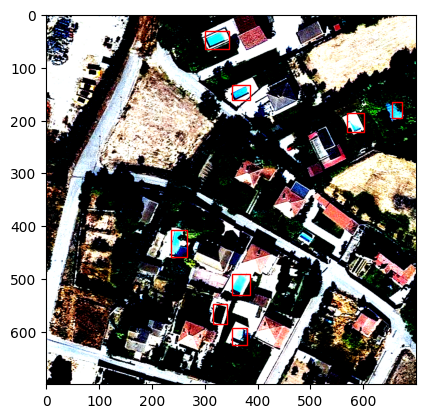

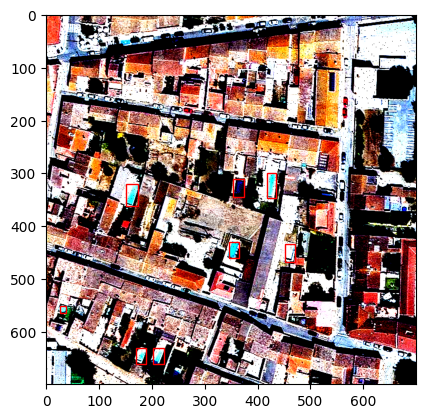

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


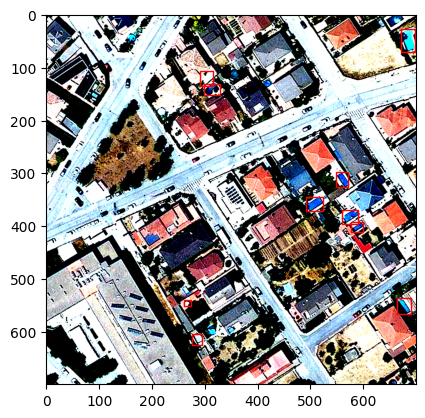

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


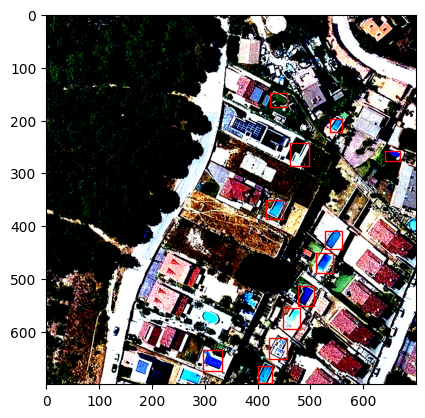

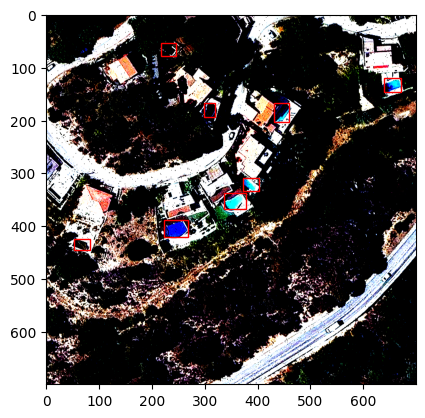

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


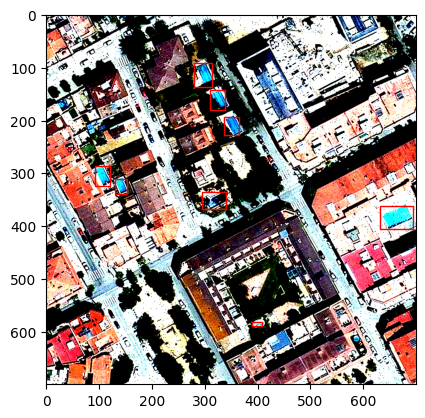

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


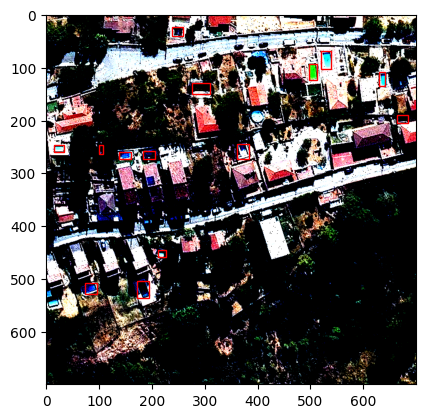

KeyboardInterrupt: 

In [40]:
for images, targets in data_loader_train:
    images = [image for image in images]
    targets = [{k: v for k, v in t.items()} for t in targets]
    for n in range(len(images)):
        image = images[n].cpu().numpy()
        image = np.moveaxis(np.array(image), 0, -1)
        fig, ax = plt.subplots()
        for bounding_box in targets[n]["boxes"]:
            x, y, w, h = bounding_box
            x, y, w, h = x*new_size[0], y*new_size[1], w*new_size[0], h*new_size[1]
            bb = patches.Rectangle((x, y), w, h, linewidth=1, edgecolor='r', facecolor='none')
            ax.add_patch(bb)
        ax.imshow(image)
        plt.show()

In [23]:
current_test = 58
current_epoch = 299
path_current_test = f'{paths["tests"]}test {current_test}/'
with open(f"{path_current_test}model_loss_{current_epoch}.json", 'r') as f:
    t_loss, v_loss = json.load(f)
model = torch.load(f'{path_current_test}model_{current_epoch}.pt')


{'learning_rate': 0.0001, 'max_lr': 0.0001, 'momentum': 0.9, 'batch_size': 8, 'epochs': 500, 'num_classes': 1, 'num_predictions': 300, 'weight_decay': 0.0001, 'notes': '', 'current_epoch': 300}


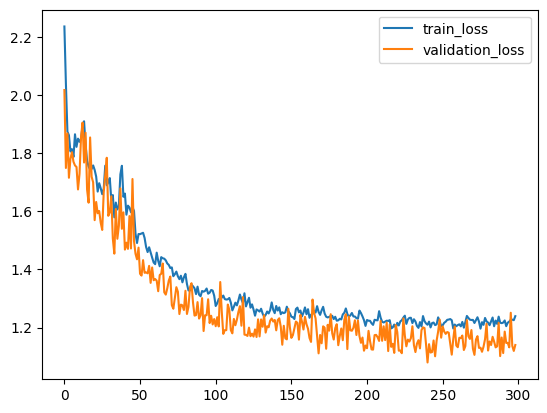

In [24]:
plt.plot(t_loss, label="train_loss")
plt.plot(v_loss, label="validation_loss")
plt.legend()
print(paramaters)

In [30]:
indice = t_loss.index(min(t_loss))
print(t_loss[indice], v_loss[indice], t_loss[indice] + v_loss[indice], indice)

1.1965318773616223 1.1309895891282293 2.3275214664898516 275


In [31]:
indice = v_loss.index(min(v_loss))
print(t_loss[indice], v_loss[indice], t_loss[indice] + v_loss[indice], indice)

1.2098281000163924 1.080046712193224 2.289874812209616 240


/tmp/ipykernel_31471/238621726.py:25: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  images.append(torch.tensor(image))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


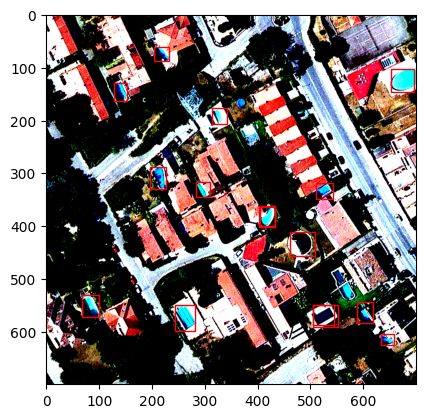

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14


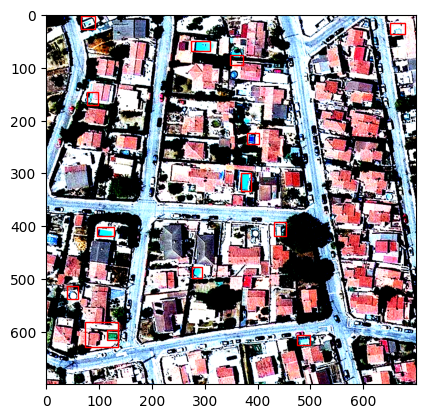

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


30


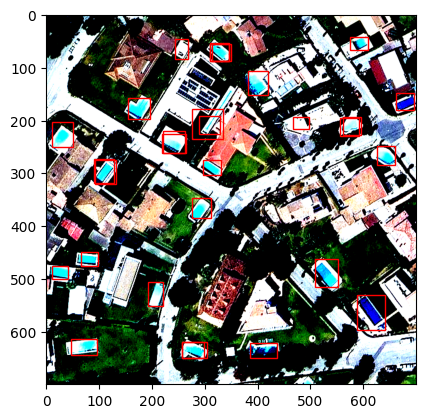

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


25


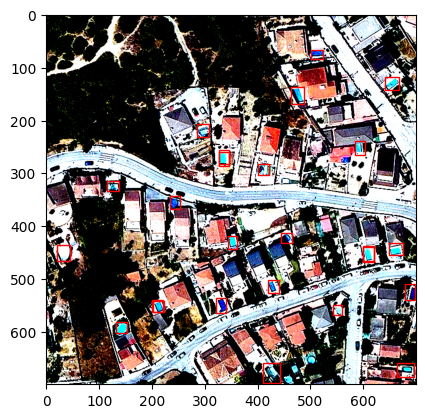

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


35


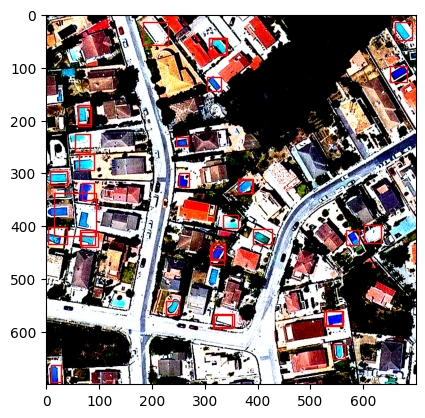

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


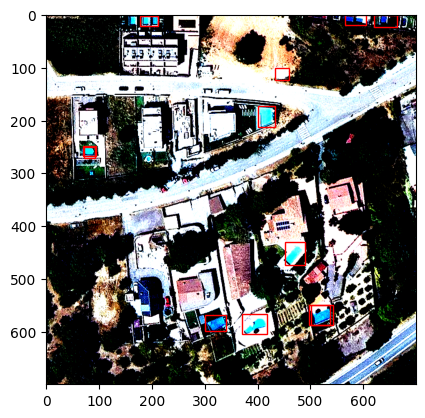

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


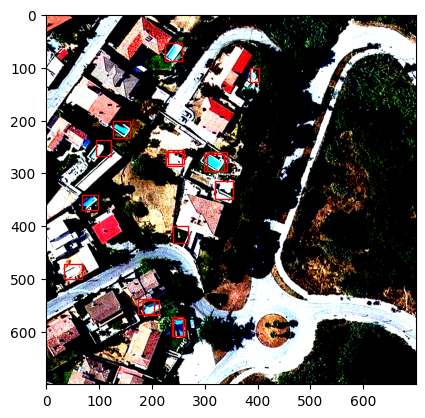

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


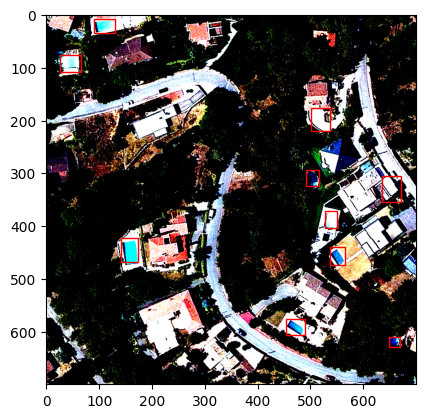

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


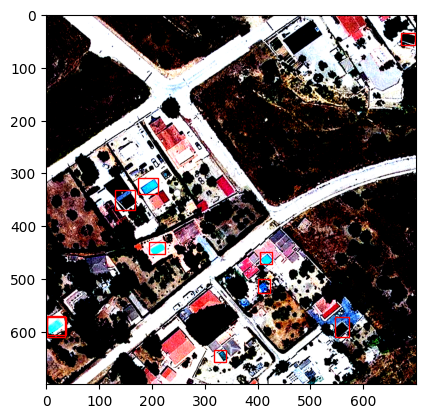

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


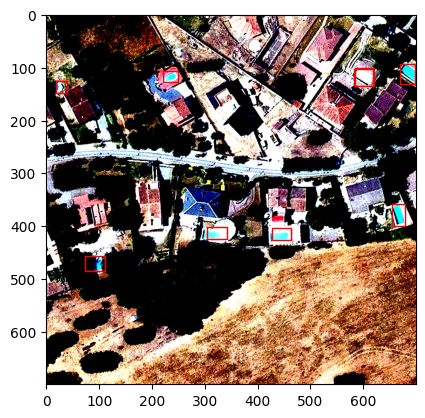

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


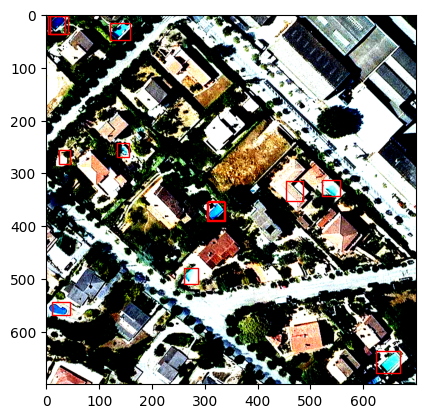

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


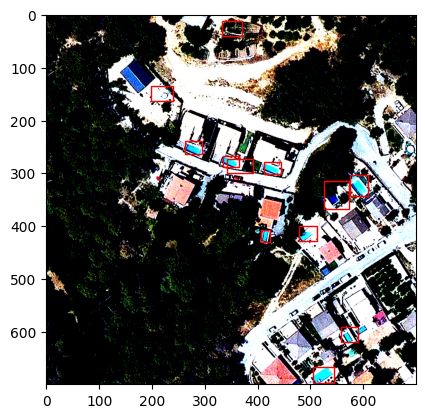

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


17


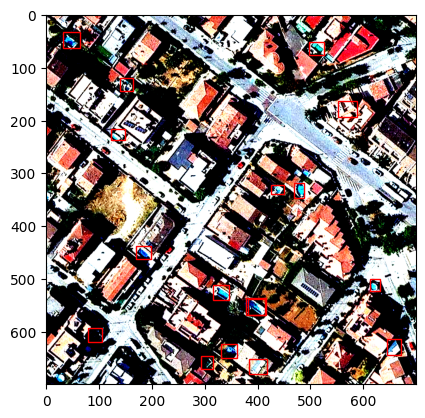

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


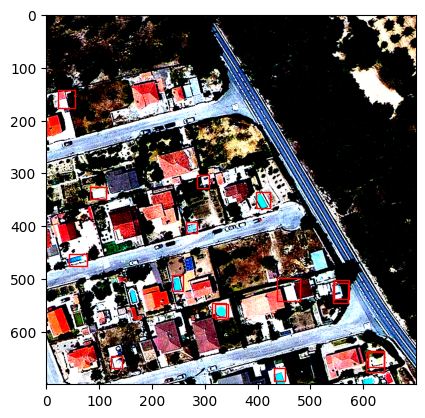

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


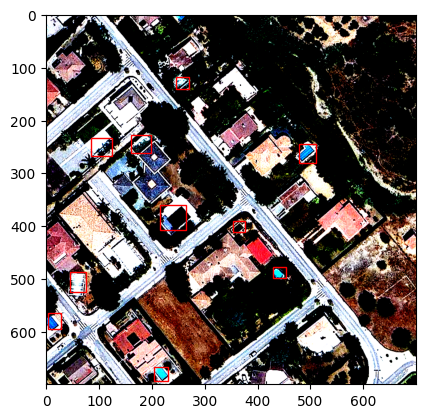

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


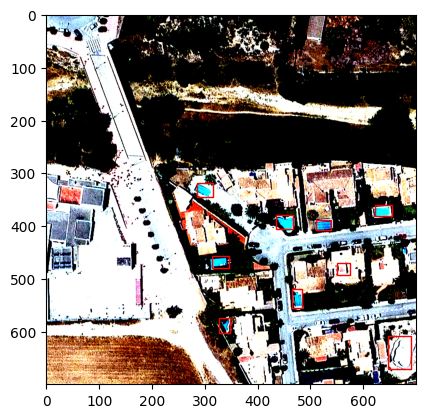

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


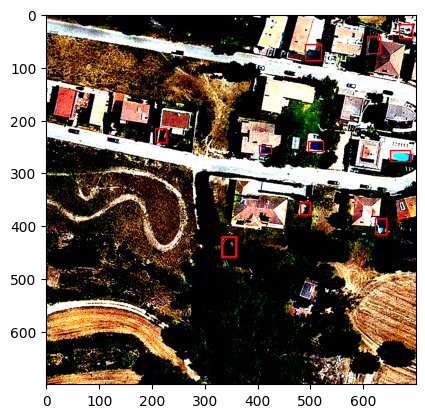

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15


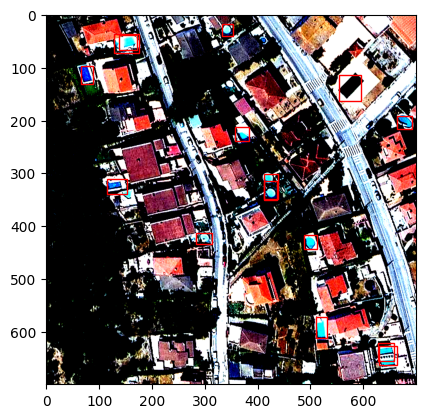

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15


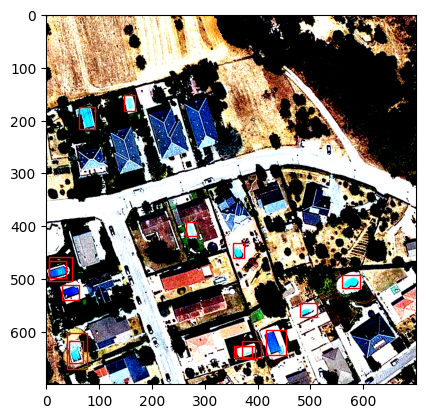

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


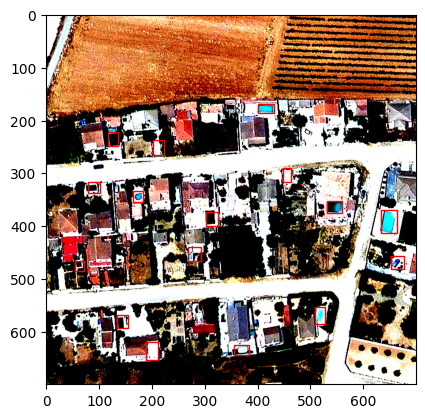

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


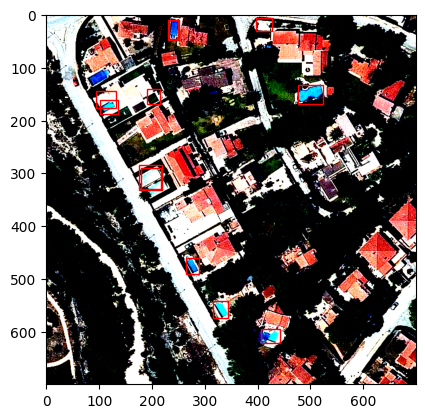

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


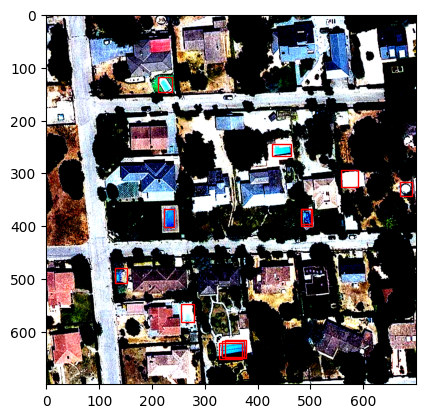

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


17


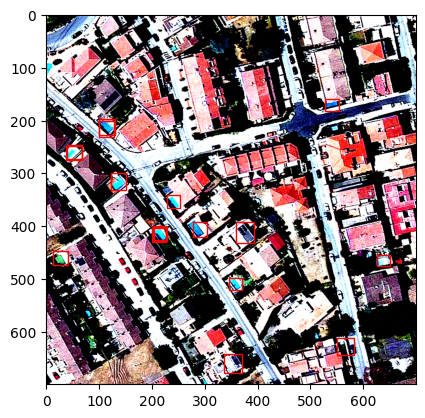

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


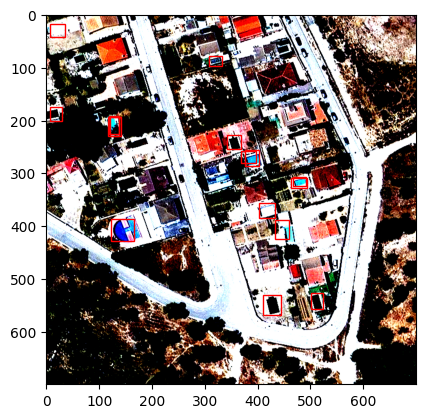

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


21


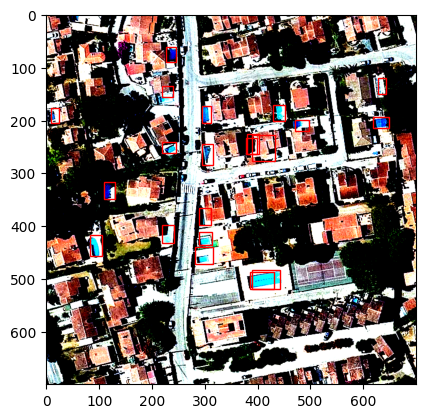

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


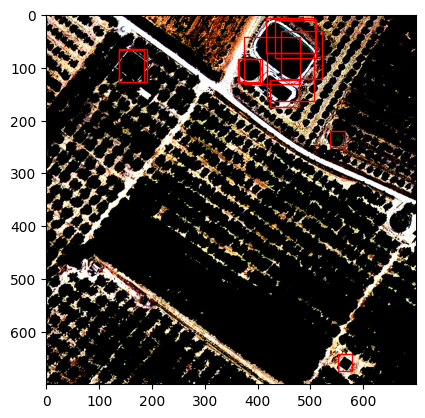

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


24


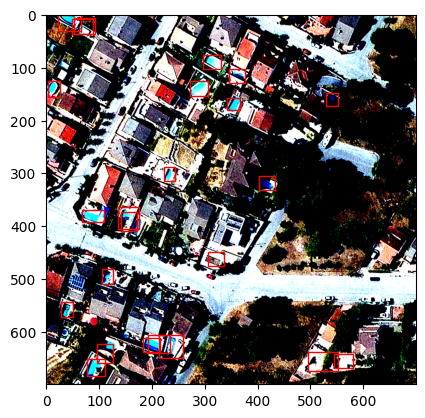

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


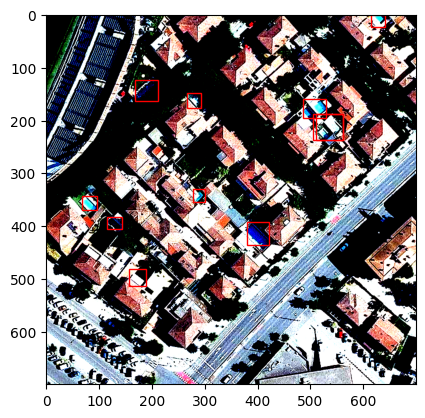

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


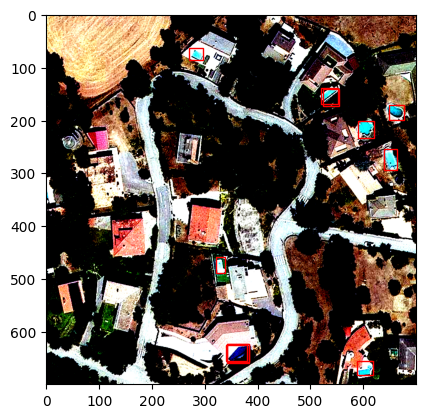

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15


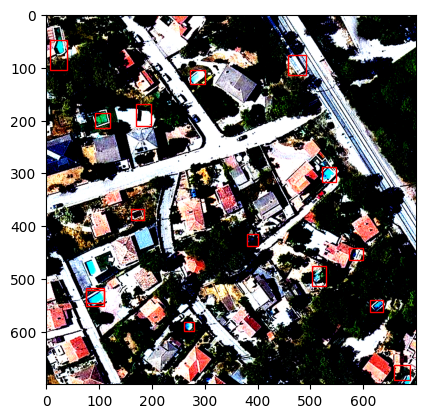

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


18


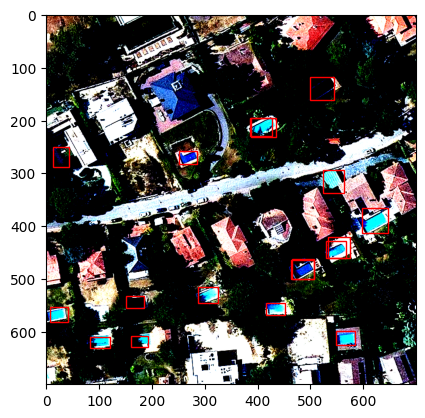

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


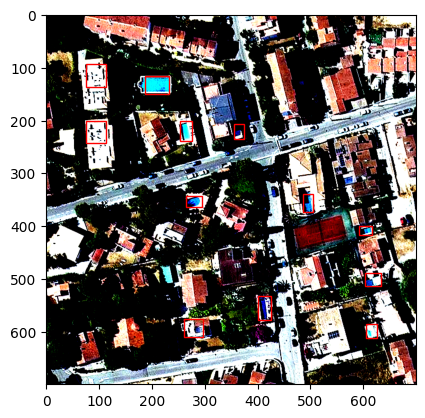

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


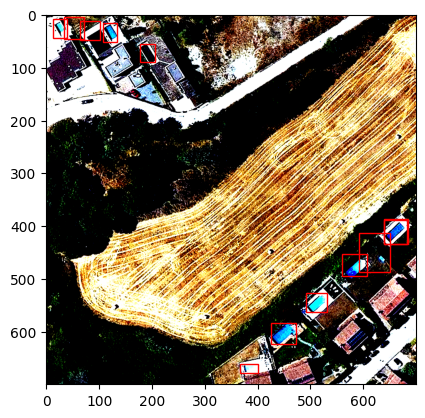

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


20


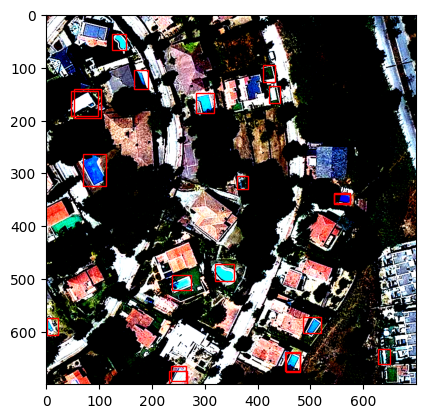

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


27


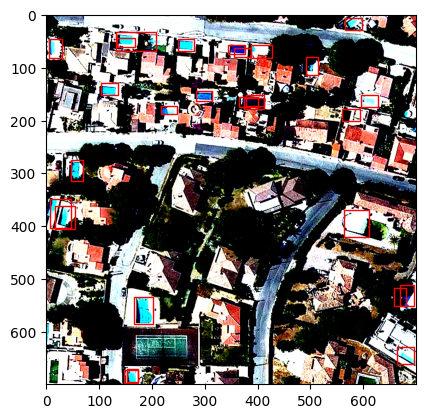

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


23


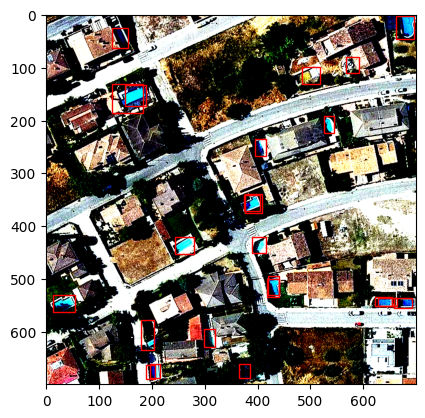

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


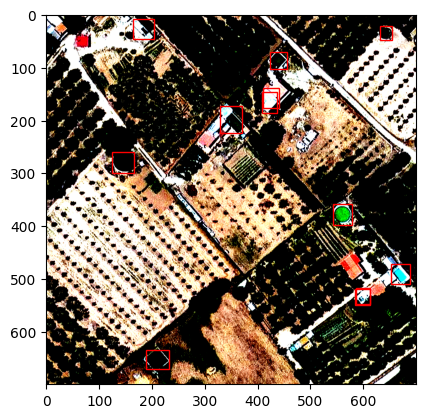

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


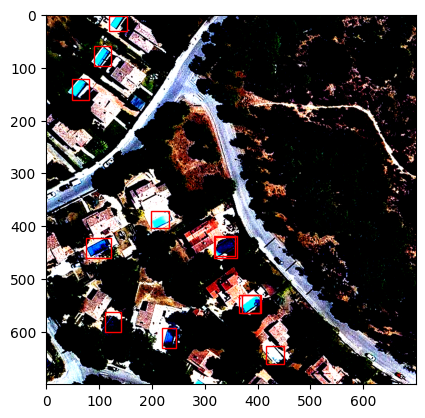

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


26


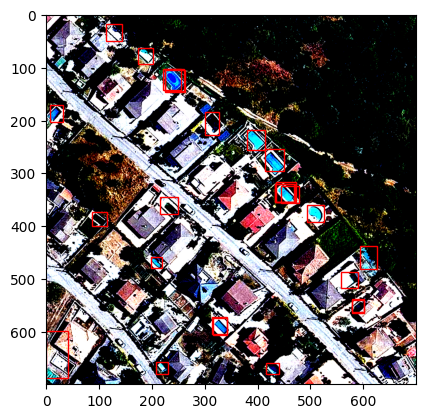

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


29


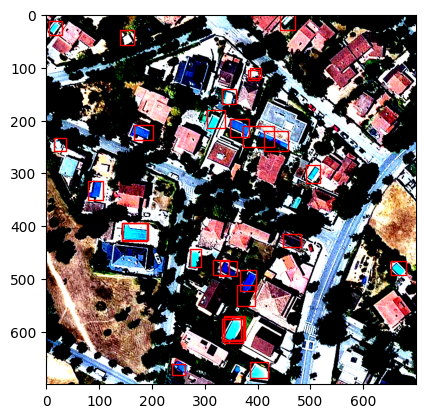

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14


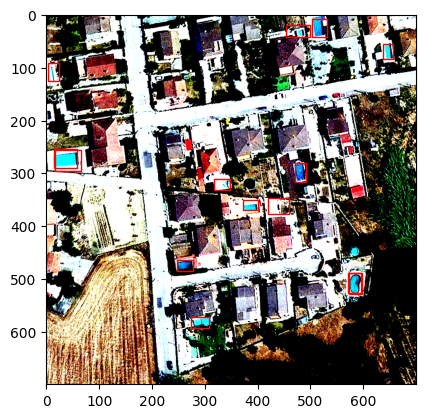

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


6


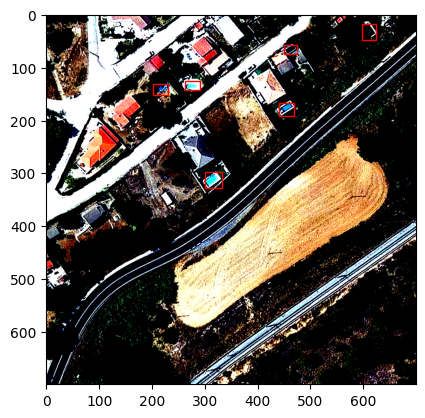

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


KeyboardInterrupt: 

In [30]:
threshold = 0.1

for images, targets in data_loader_validation:
    images = [image.to(device) for image in images]
    targets = [{k: v for k, v in t.items()} for t in targets]
    output = model(images)
    for n in range(len(images)):
        image = images[n].cpu().numpy()
        image = np.moveaxis(image, 0, -1)
        mask = output["pred_logits"][n] > threshold
        mask = torch.cat((mask, mask, mask, mask), 1)
        pred_boxes = cxcywh_to_xywh(output["pred_boxes"][n][mask].reshape(-1, 4))
        if pred_boxes.shape[0] > 0:
            fig, ax = plt.subplots()
            print(pred_boxes.shape[0])
            for bounding_box in pred_boxes:
                x, y, w, h = bounding_box.cpu().detach().numpy()
                x, y, w, h = x*new_size[0], y*new_size[1], w*new_size[0], h*new_size[1]
                bb = patches.Rectangle((x, y), w, h, linewidth=1, edgecolor='r', facecolor='none')
                ax.add_patch(bb)
            ax.imshow(image)
            plt.show()

In [39]:
output

{'pred_logits': tensor([[[5.1879e-03],
          [9.6531e-02],
          [1.8723e-03],
          [9.7952e-03],
          [4.5389e-03],
          [4.6989e-03],
          [7.2345e-03],
          [1.2076e-02],
          [3.4051e-02],
          [8.9260e-03],
          [4.1366e-03],
          [4.0779e-03],
          [5.2339e-04],
          [7.1648e-04],
          [4.4206e-03],
          [2.4574e-01],
          [4.5970e-03],
          [1.7998e-03],
          [1.6366e-03],
          [2.1361e-03],
          [2.8068e-03],
          [7.3435e-04],
          [1.8723e-03],
          [1.1794e-03],
          [4.1793e-03],
          [8.1176e-03],
          [1.6220e-03],
          [2.3321e-03],
          [1.0867e-02],
          [7.0740e-01],
          [1.7434e-03],
          [1.4179e-03],
          [3.6117e-03],
          [1.1286e-03],
          [2.8710e-03],
          [5.8006e-02],
          [1.0200e-03],
          [4.0282e-01],
          [5.9552e-04],
          [2.1370e-01],
          [1.4824e-03],
 

In [45]:
model = PoolDetectionModel(1)
model.to(device)
model.train()
model.zero_grad()
for images, targets in data_loader_train:
    images = [image.to(device) for image in images]
    output = model(images)
    loss = output["pred_boxes"].sum()
#     print(loss.is_leaf)
#     loss.backward(retain_graph=True)
    make_dot(loss, params=dict(model.named_parameters()), show_attrs=True, show_saved=True).render('graph', format='pdf', directory='/tf')
    break

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


KeyboardInterrupt: 

In [13]:
import shutil
for i in [9]:
    shutil.rmtree("/tf/data/tmp/PoolsDS/tests/test "+str(i))

In [30]:
train_loss = [1,2,3,4,5,6,7,8,9]
val_loss = [9,6,3,2,5,8,7,4,1]
losses = [train_loss, val_loss]
losses

[[1, 2, 3, 4, 5, 6, 7, 8, 9], [9, 6, 3, 2, 5, 8, 7, 4, 1]]

In [31]:
with open(f"{paths['test']}model_loss_test.json", 'w') as f:
            json.dump(losses, f)

In [32]:
train_loss = False
val_loss = False

In [34]:
with open(f"{paths['test']}model_loss_test.json", 'r') as f:
    losses = json.load(f)
    
train_loss, val_loss = losses
print(train_loss)
print(val_loss)

[1, 2, 3, 4, 5, 6, 7, 8, 9]
[9, 6, 3, 2, 5, 8, 7, 4, 1]


In [46]:
DatasetCatalog.clear()
MetadataCatalog.clear()

# Registrar instancia de COCO
register_coco_instances("piscinas_test", {}, paths["annotations_test"], paths["images_test"])
# Cargar la instancia de COCO como un objeto Dataset
dataset_name = "piscinas_test"
dataset = DatasetCatalog.get(dataset_name)
# Obtener metadatos del dataset
metadata = MetadataCatalog.get(dataset_name)
# Declarar el DataLoader
data_loader_test = DataLoader(dataset, batch_size=paramaters["batch_size"], collate_fn=collate_fn)

WARNING [06/26 17:55:17 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/26 17:55:17 d2.data.datasets.coco]: Loaded 945 images in COCO format from /tf/data/tmp/PoolsDS/Dataset improved 3/test/_annotations.coco.json


/tmp/ipykernel_29911/238621726.py:25: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  images.append(torch.tensor(image))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


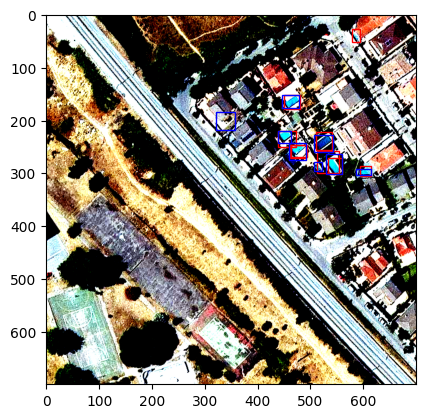

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8


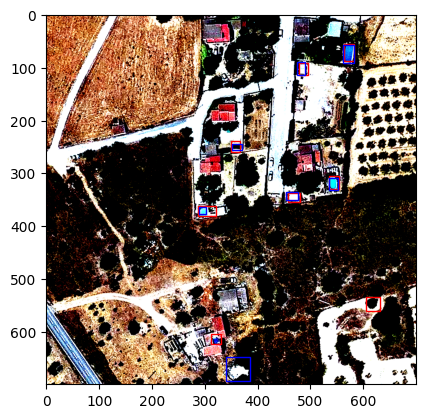

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


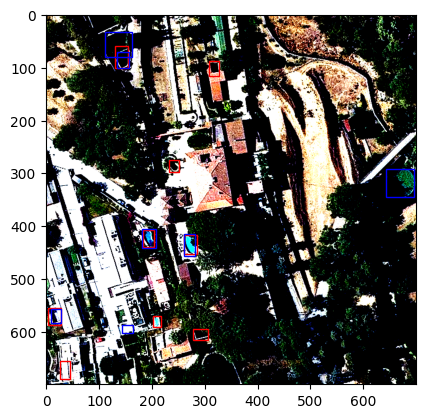

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


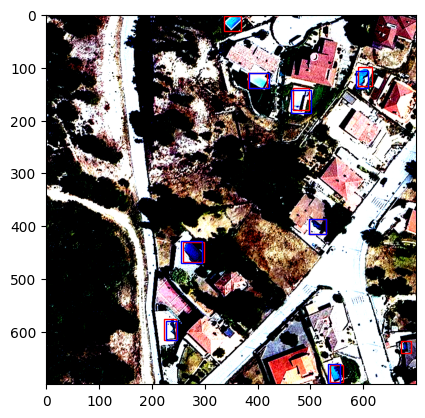

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


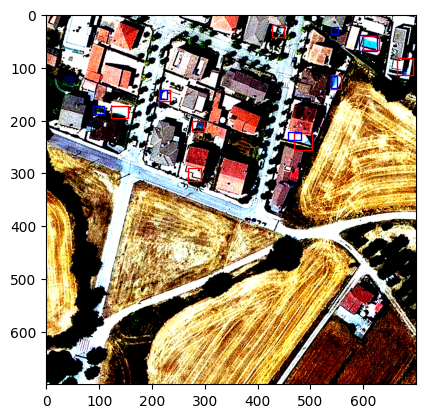

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8


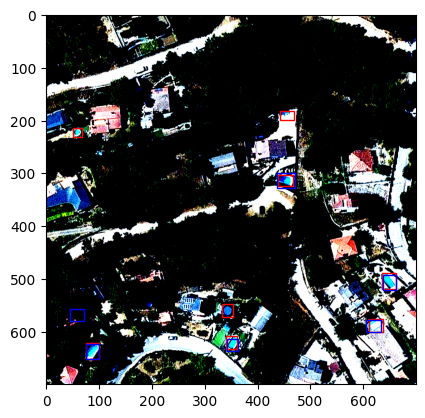

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


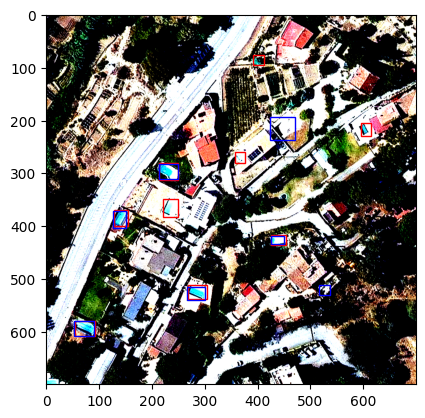

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


25


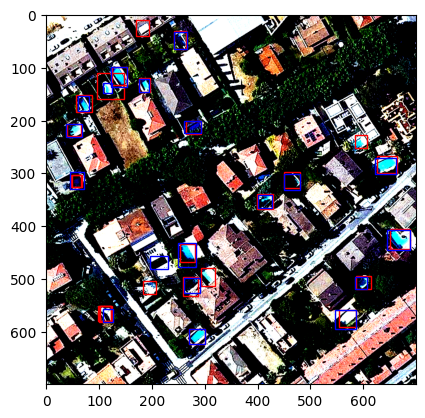

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15


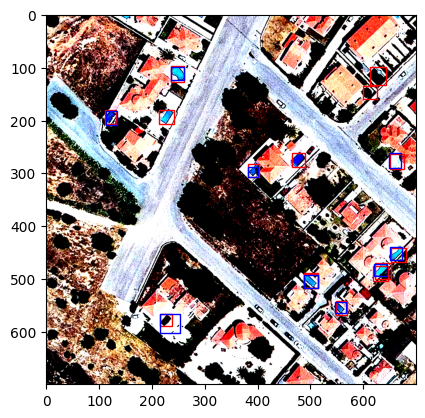

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


7


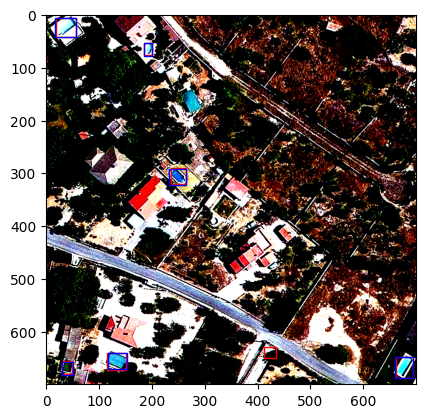

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


41


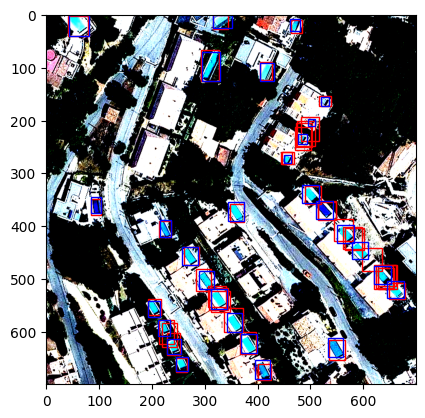

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15


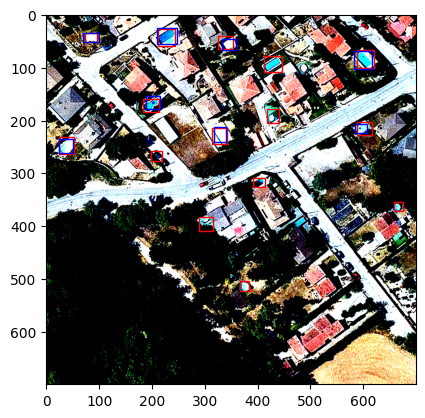

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


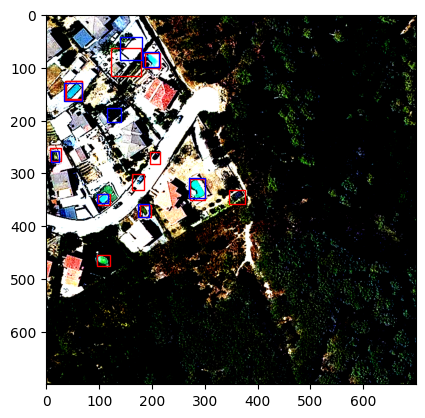

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


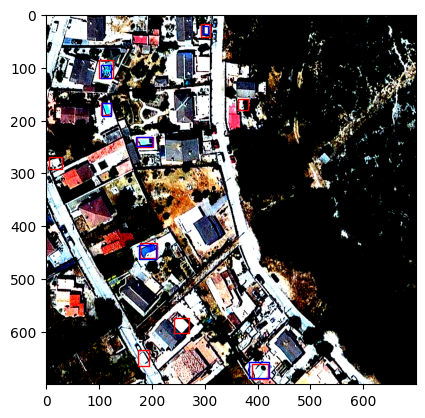

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


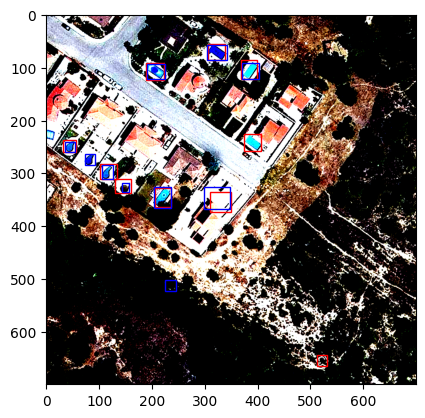

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15


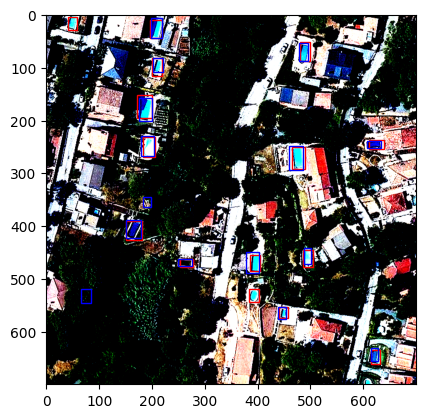

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


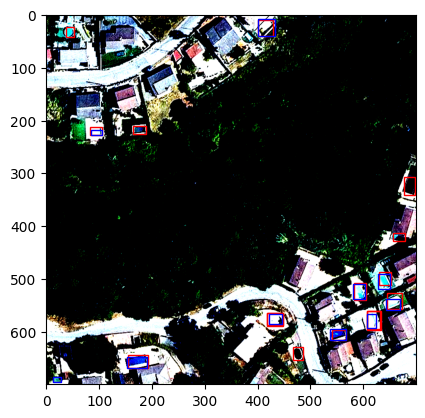

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15


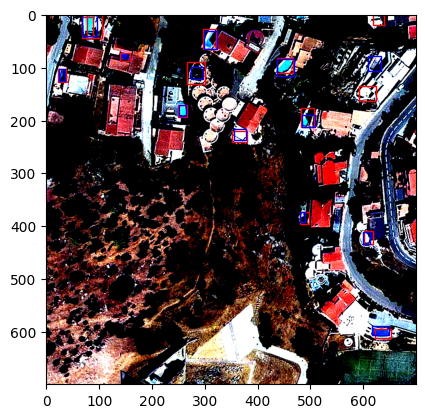

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


19


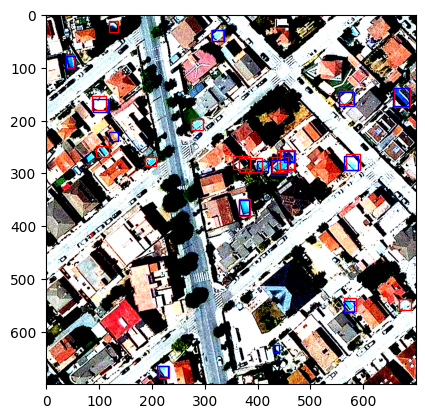

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


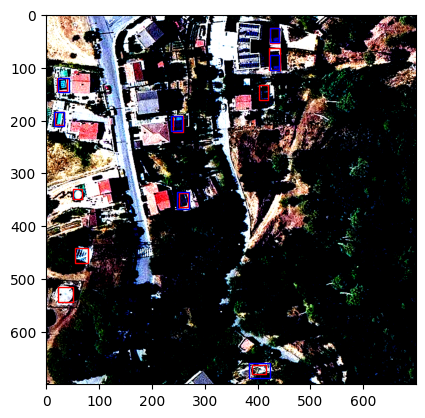

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


17


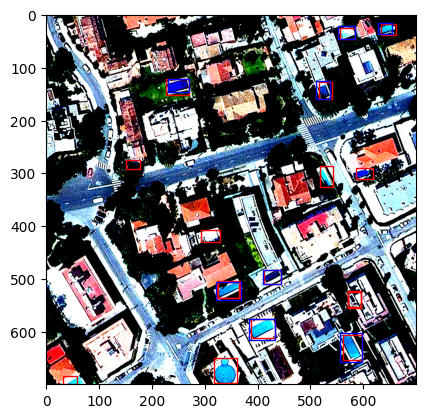

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


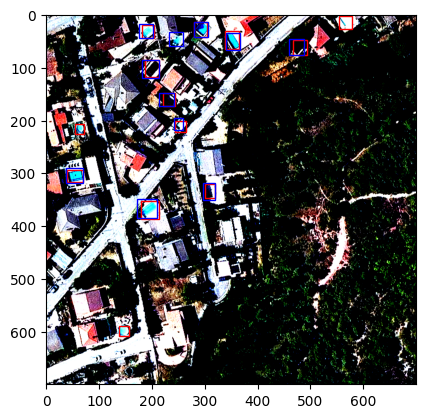

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


28


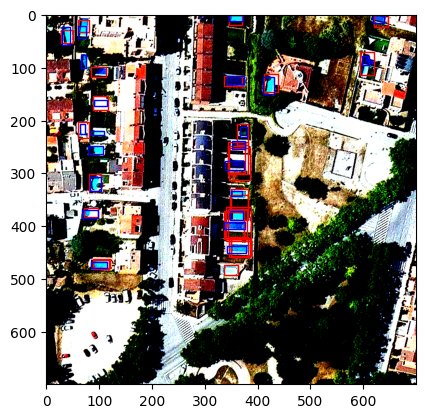

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


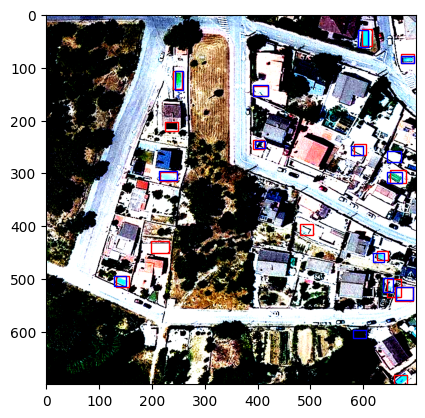

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


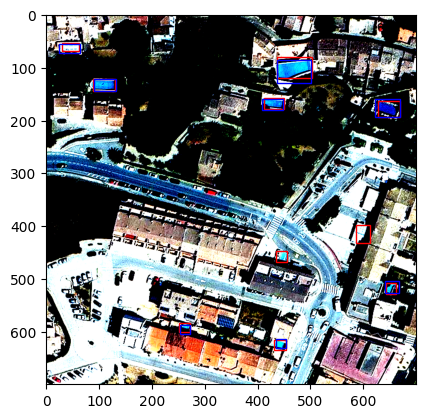

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8


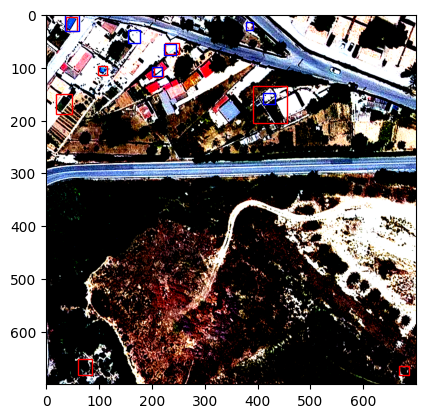

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


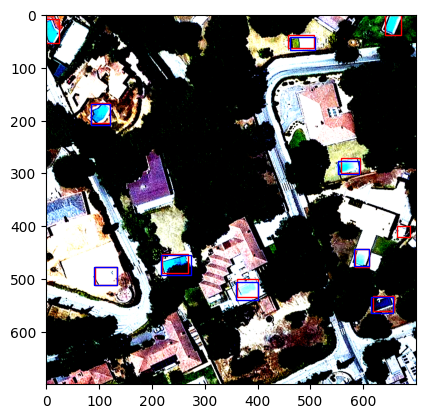

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


19


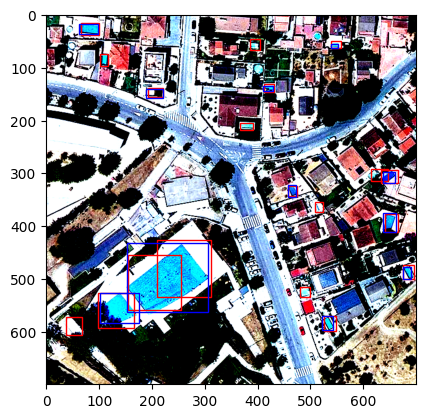

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


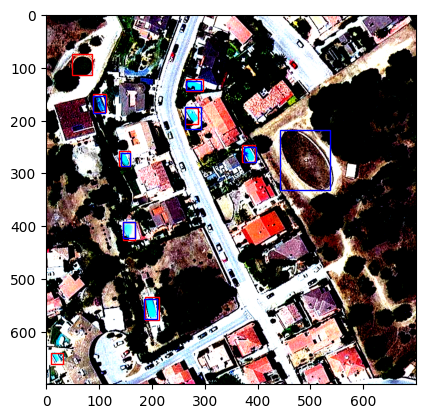

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


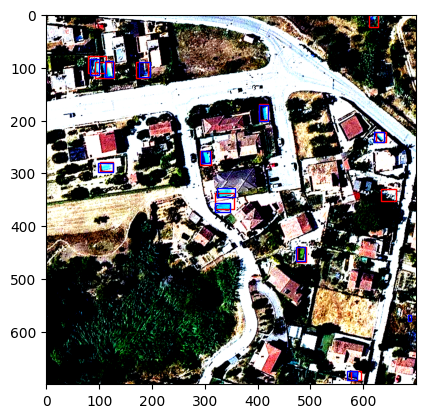

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


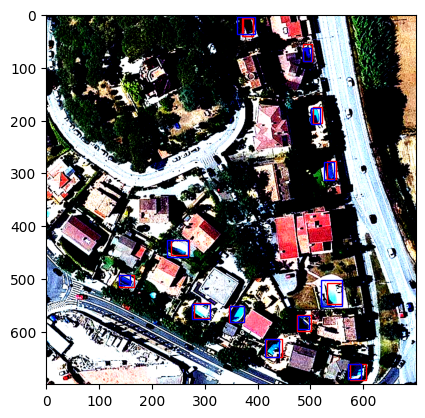

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


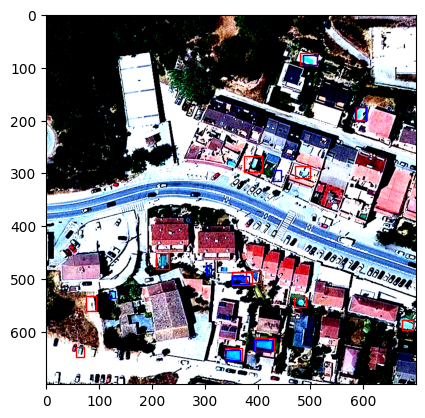

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


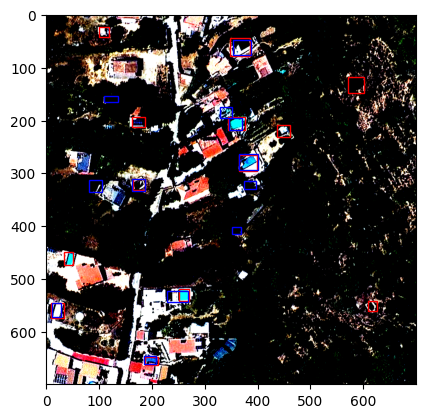

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


18


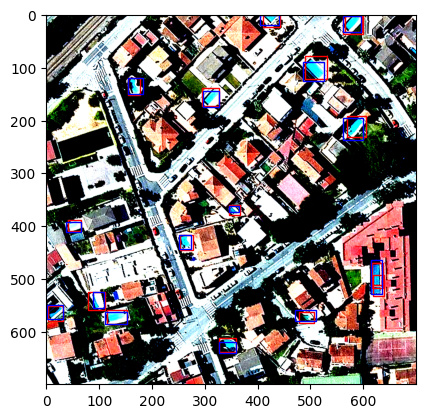

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


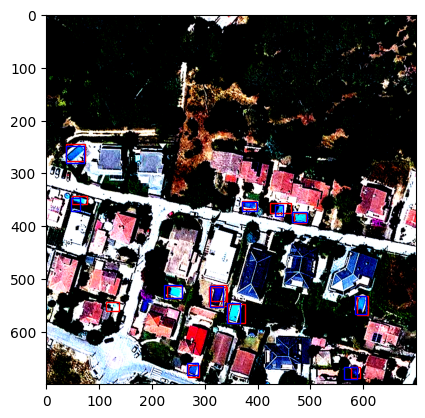

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


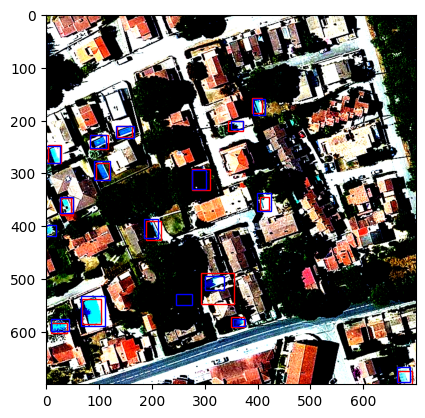

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


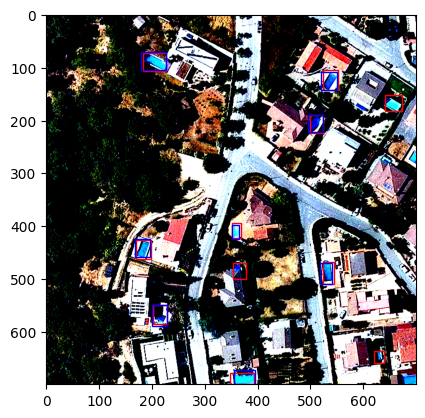

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8


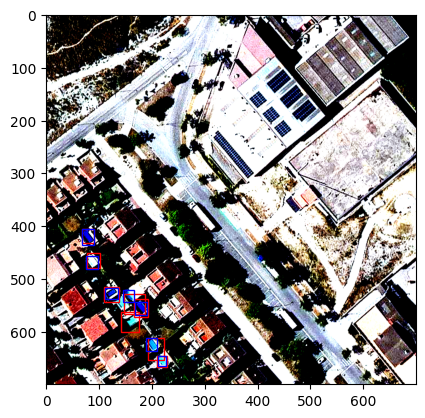

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


7


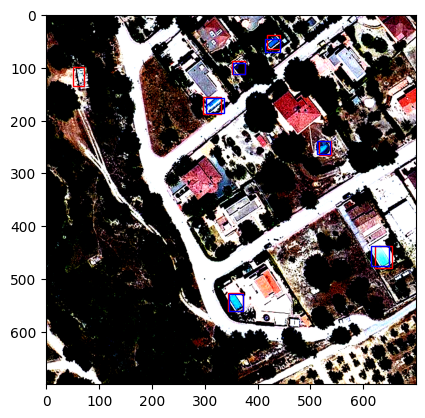

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


19


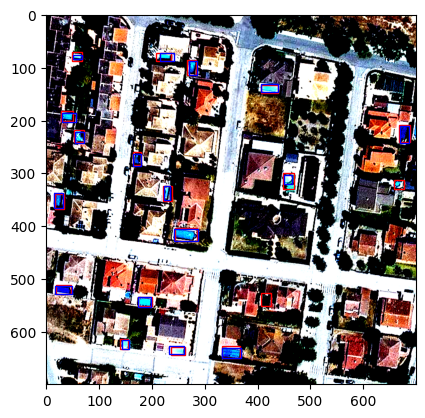

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14


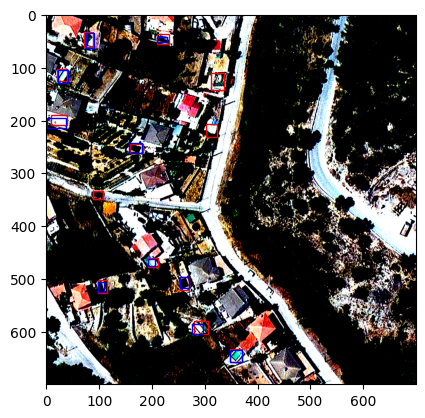

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


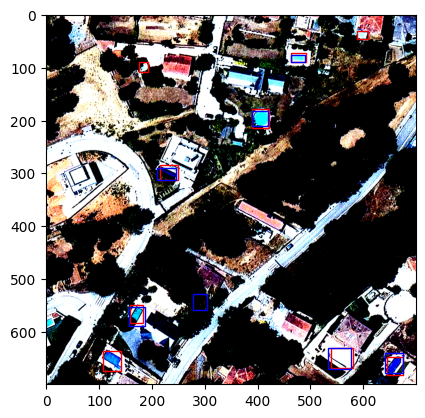

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


32


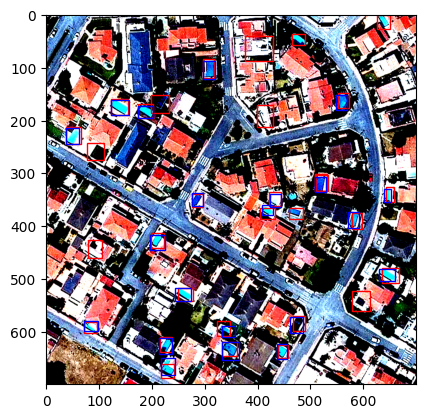

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


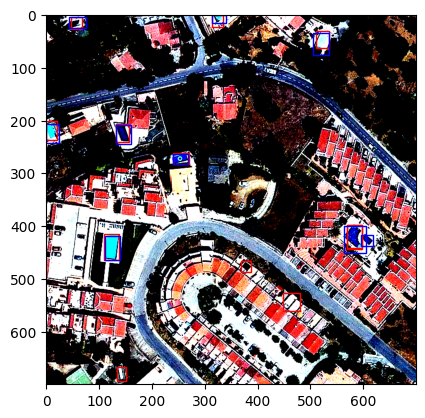

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14


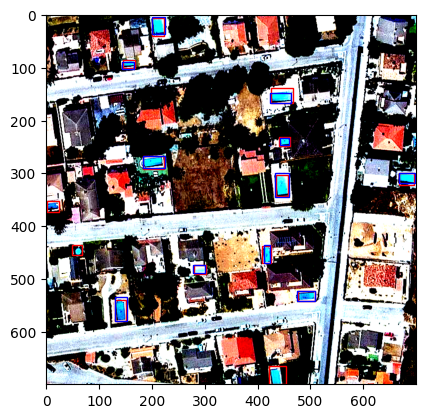

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


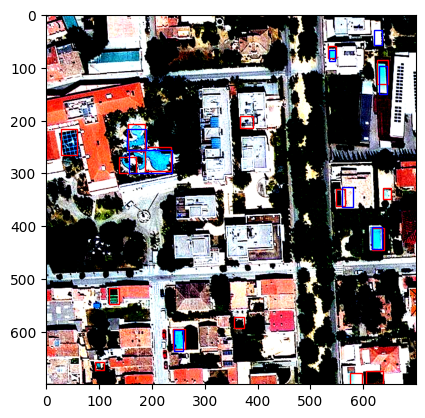

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8


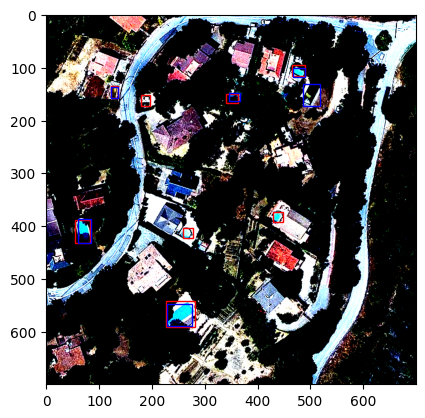

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14


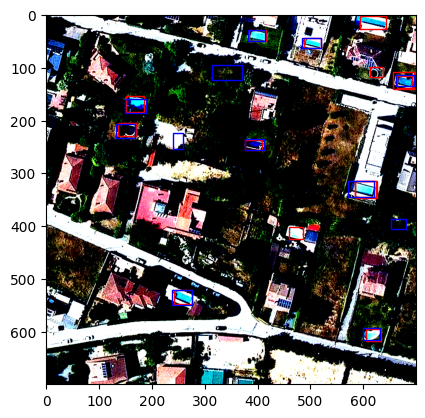

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


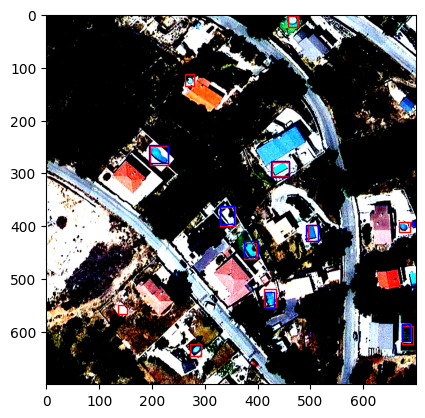

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


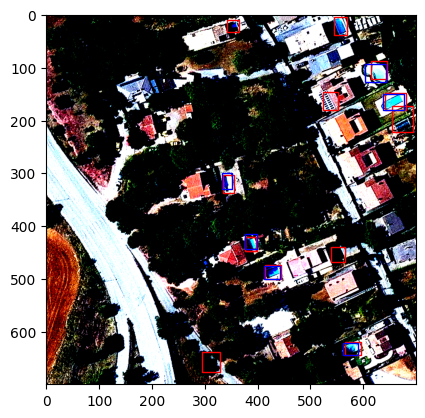

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


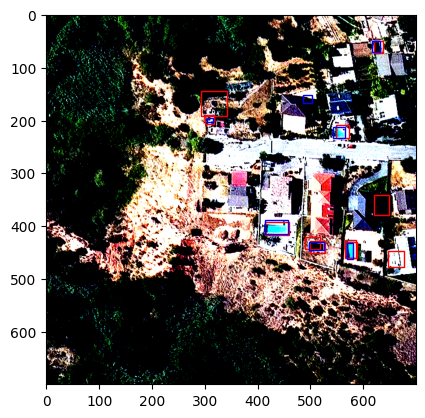

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


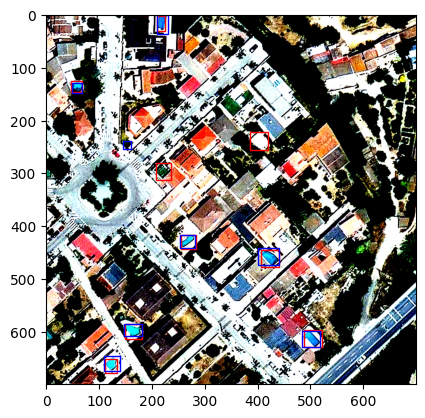

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


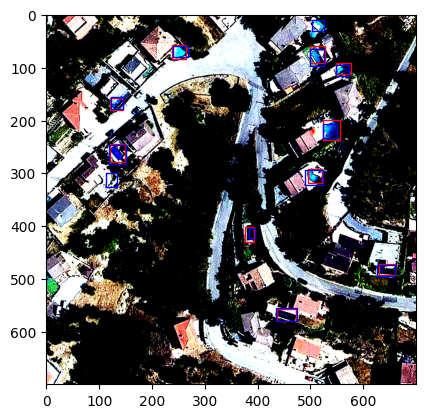

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


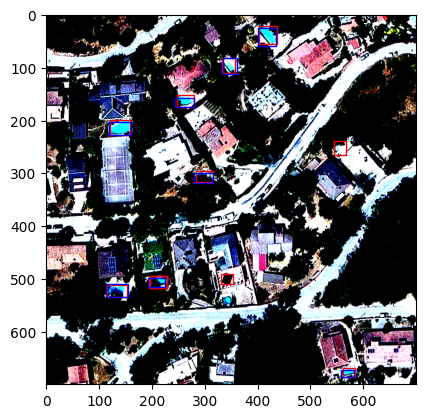

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


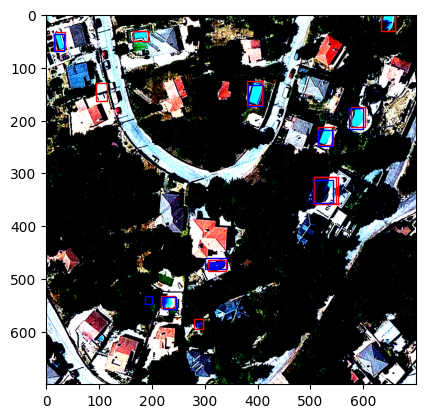

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


17


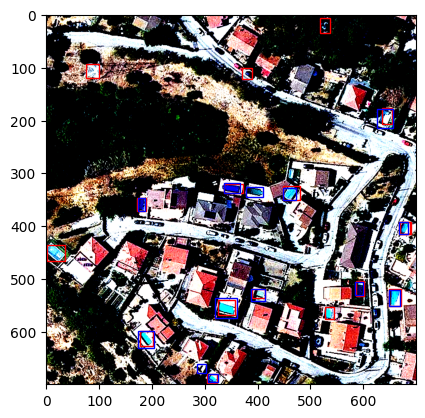

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


7


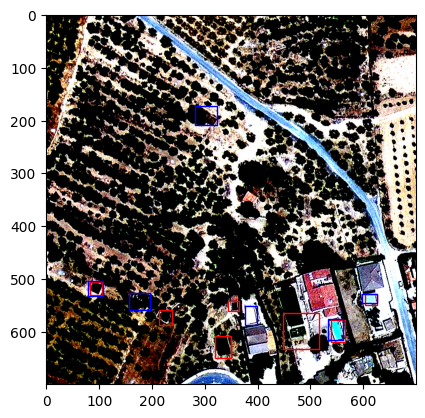

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8


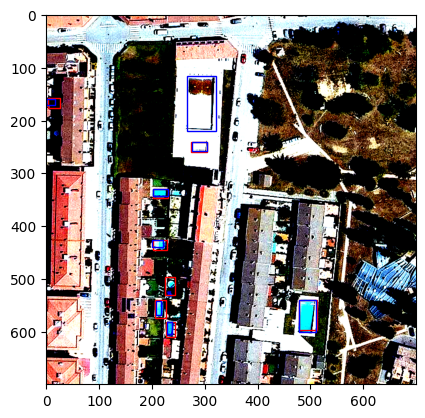

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


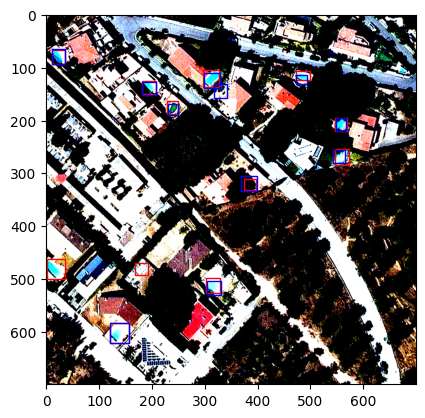

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15


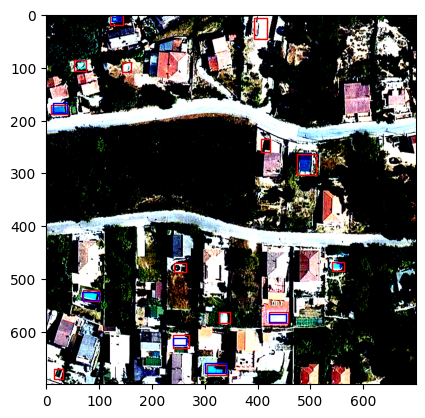

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


19


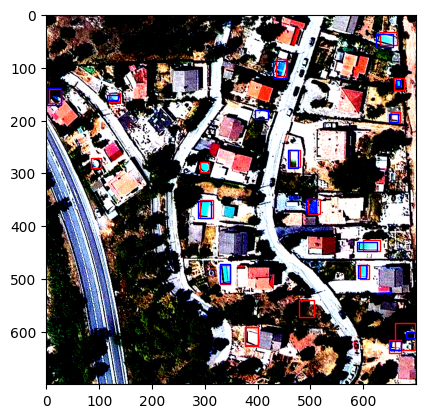

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


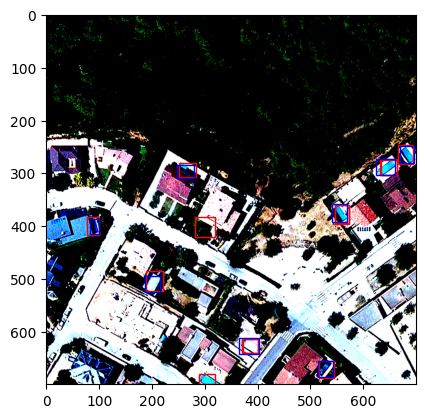

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


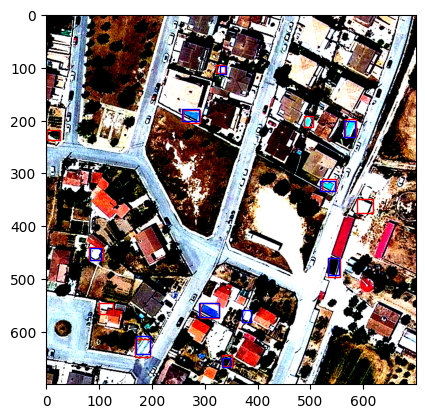

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


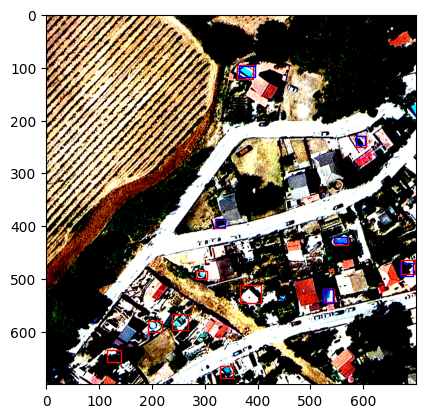

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


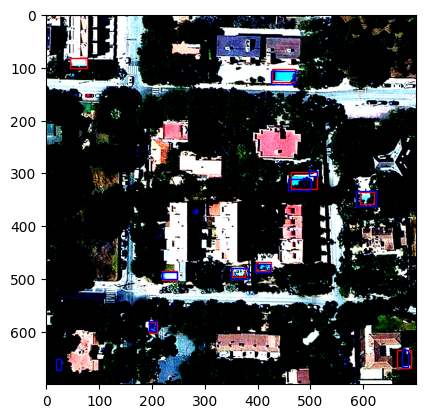

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


27


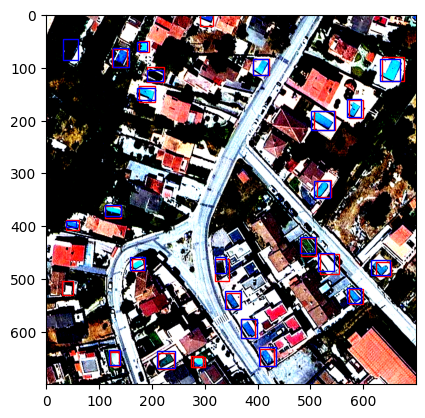

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


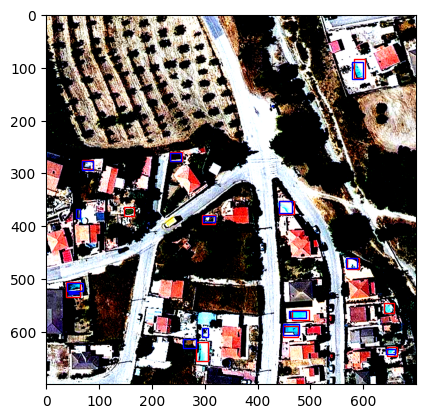

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


17


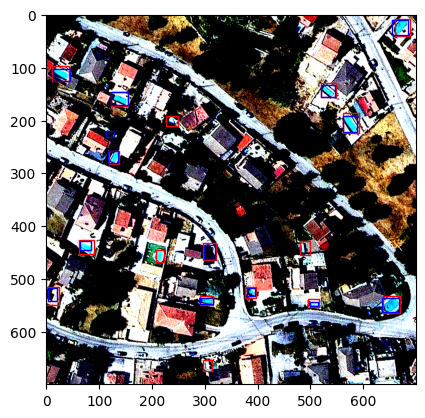

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


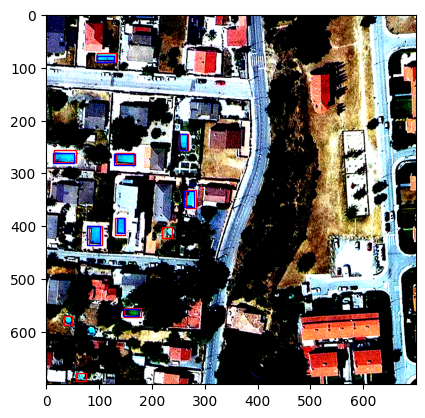

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8


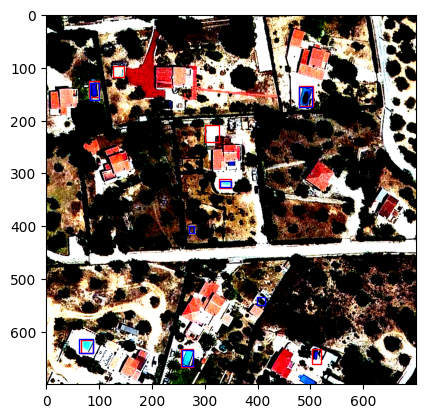

KeyboardInterrupt: 

<Figure size 640x480 with 0 Axes>

In [47]:
model.eval()

threshold = 0.1
for images, targets in data_loader_test:
    images = [image.to(device) for image in images]
    targets = [{k: v for k, v in t.items()} for t in targets]
    output = model(images)
    for n in range(len(images)):
        image = images[n].cpu().numpy()
        image = np.moveaxis(image, 0, -1)
        mask = output["pred_logits"][n] > threshold
        mask = torch.cat((mask, mask, mask, mask), 1)
        pred_boxes = cxcywh_to_xywh(output["pred_boxes"][n][mask].reshape(-1, 4))
        if pred_boxes.shape[0] > 0:
            fig, ax = plt.subplots()
            print(pred_boxes.shape[0])
            for bounding_box in pred_boxes:
                x, y, w, h = bounding_box.cpu().detach().numpy()
                x, y, w, h = x*new_size[0], y*new_size[1], w*new_size[0], h*new_size[1]
                bb = patches.Rectangle((x, y), w, h, linewidth=1, edgecolor='r', facecolor='none')
                ax.add_patch(bb)
            for bounding_box in targets[n]["boxes"]:
                x, y, w, h = bounding_box
                x, y, w, h = x*new_size[0], y*new_size[1], w*new_size[0], h*new_size[1]
                bb = patches.Rectangle((x, y), w, h, linewidth=1, edgecolor='b', facecolor='none')
                ax.add_patch(bb)
            ax.imshow(image)
            plt.show()